# Filter image list

In [1]:
import json

MARKUP_JSON = '..\..\..\merged_markup.json'

with open(MARKUP_JSON) as f:
    markup_data = json.load(f)

In [2]:
import os

img_with_marked_pilots_paths = []
diff_pilots_count = 0
pilot_numbers = {}
img_path_to_pilot_num = {}

for dataset_part, markup in markup_data.items():
    for img_name, markup_line in markup.items():
        pilots_count = len(markup_line.split(';')) if len(markup_line) else 0
        
        if pilots_count == 1 and markup_line != '0':
            pilot_num = int(markup_line)
            
            if pilot_num not in pilot_numbers:
                pilot_numbers[pilot_num] = 1
            else:
                pilot_numbers[pilot_num] += 1
            
            img_path = os.path.join('..\..\..', dataset_part, img_name)
            
            if os.path.exists(img_path):
                img_with_marked_pilots_paths.append(img_path)
                img_path_to_pilot_num[img_path] = pilot_num

len(img_with_marked_pilots_paths), len(list(pilot_numbers.keys()))

(1625, 176)

In [3]:
MIN_FREQ = 20

filtered_img_with_marked_pilots_paths = [
    img_path for img_path in img_with_marked_pilots_paths if pilot_numbers[img_path_to_pilot_num[img_path]] >= MIN_FREQ
]
most_freq_pilots_nums = [pilot_idx for pilot_idx in pilot_numbers.keys() if pilot_numbers[pilot_idx] >= MIN_FREQ]

len(filtered_img_with_marked_pilots_paths), len(most_freq_pilots_nums)

(959, 37)

In [4]:
import sys
sys.path.append('..')

from src import Processing

DATASET_PART_FOLDER = r"C:\Users\Ася\Desktop\Папки\Учёба\project_FotoMoto\8.06(2)MOTORING_25.06.22 JPG"
processor = Processing(DATASET_PART_FOLDER, hsv_flag=False, intervals_count=8, embedding_type='union')

processor.img_paths = filtered_img_with_marked_pilots_paths

# Compute embeddings

In [5]:
%%time
img_path_to_moto_embs = processor.process_all_images(processes=4)

CPU times: total: 3.05 s
Wall time: 48min 27s


In [6]:
len(img_path_to_moto_embs)

959

# t-SNE visualization

In [7]:
all_embs = []

for img_path, embs in img_path_to_moto_embs.items():
    all_embs.extend(embs)
    
img_paths = []
moto_masks = []

for img_path, embs in img_path_to_moto_embs.items():
    img_paths.extend([img_path] * len(embs))

In [8]:
from sklearn.manifold import TSNE
import numpy as np

X = np.array(all_embs)
X_embedded = TSNE(random_state=1, n_iter=15000, metric="euclidean").fit_transform(X)

x = X_embedded[:, 0]
y = X_embedded[:, 1]

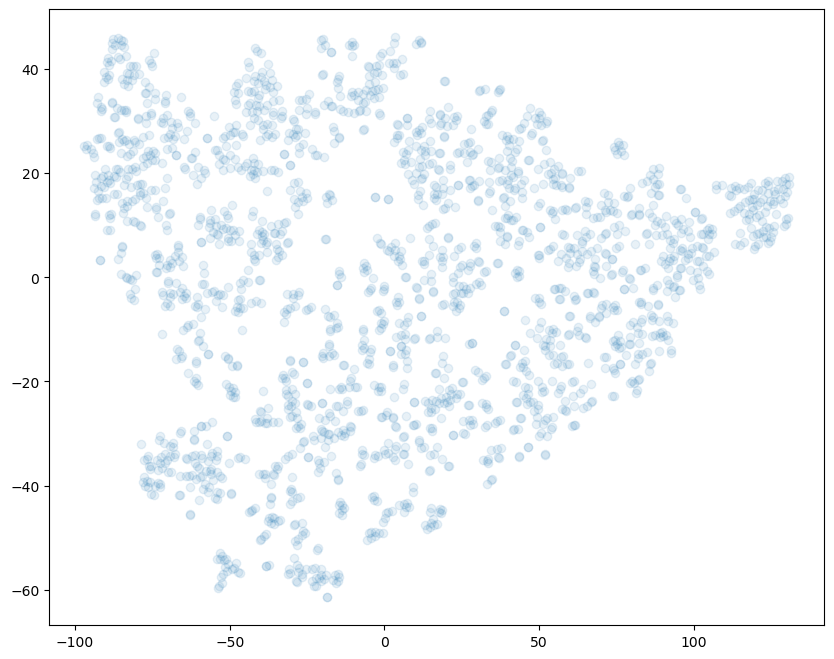

In [9]:
import matplotlib.pyplot as plt

%matplotlib inline

fig, ax = plt.subplots(figsize=(10, 8))
# Make points translucent so we can visually identify regions with a high density of overlapping points
ax.scatter(x, y, alpha=.1);

# Clustering with DBSCAN

In [10]:
img_paths = []

for img_path, embs in img_path_to_moto_embs.items():
    img_paths.extend([img_path] * len(embs))

In [11]:
assert len(X) == len(img_paths)

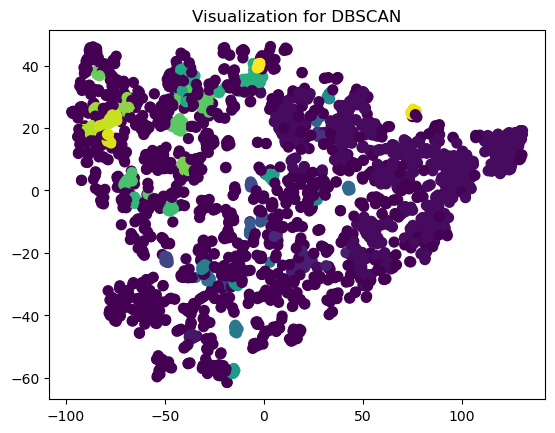

In [30]:
from sklearn.cluster import DBSCAN

# define the model
dbscan_model = DBSCAN(eps=0.05, min_samples=5)

# assign each data point to a cluster
dbscan_result = dbscan_model.fit_predict(X)

# get all of the unique clusters
dbscan_clusters = np.unique(dbscan_result)

plt.title(f'Visualization for DBSCAN')
plt.scatter(x, y, c=dbscan_result, s=50, cmap='viridis')
plt.show()

In [32]:
dbscan_clusters

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34], dtype=int64)

In [36]:
import cv2
import rawpy
import random

def show_cluster_examples_imgs(
    cluster_id: int, dbscan_result, img_paths,
    max_examples: int = 12,
    cols: int = 3, img_size_on_plot: int = 5,
):
    cluster_elems_ids = np.argwhere(dbscan_result == cluster_id).reshape(-1).tolist()
    print(f'Cluster={cluster_id} elems count: {len(cluster_elems_ids)}')
    
    rows = max_examples // cols

    fig = plt.figure(
        figsize=(img_size_on_plot * rows, img_size_on_plot * cols),
    )
    fig.suptitle(f'Examples of cluster#{cluster_id}')
    
    if len(cluster_elems_ids):
        examples_count = min(len(cluster_elems_ids), max_examples)
        examples_ids = random.sample(cluster_elems_ids, examples_count)
        
        for i, idx in enumerate(examples_ids):
            img_path = img_paths[idx]
            
             # read image
            if img_path.lower().endswith('.cr2'):
                raw = rawpy.imread(img_path) # access to the RAW image
                image = raw.postprocess() # a numpy RGB array
            else:
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                
            emb = img_path_to_moto_embs[img_path]
            
            fig.add_subplot(rows, cols, i+1)
            
            plt.title(f'gt pilot num: {img_path_to_pilot_num[img_path]}')
            plt.axis('off')
            plt.imshow(image)
        
        plt.show()
          

Cluster=0 elems count: 530


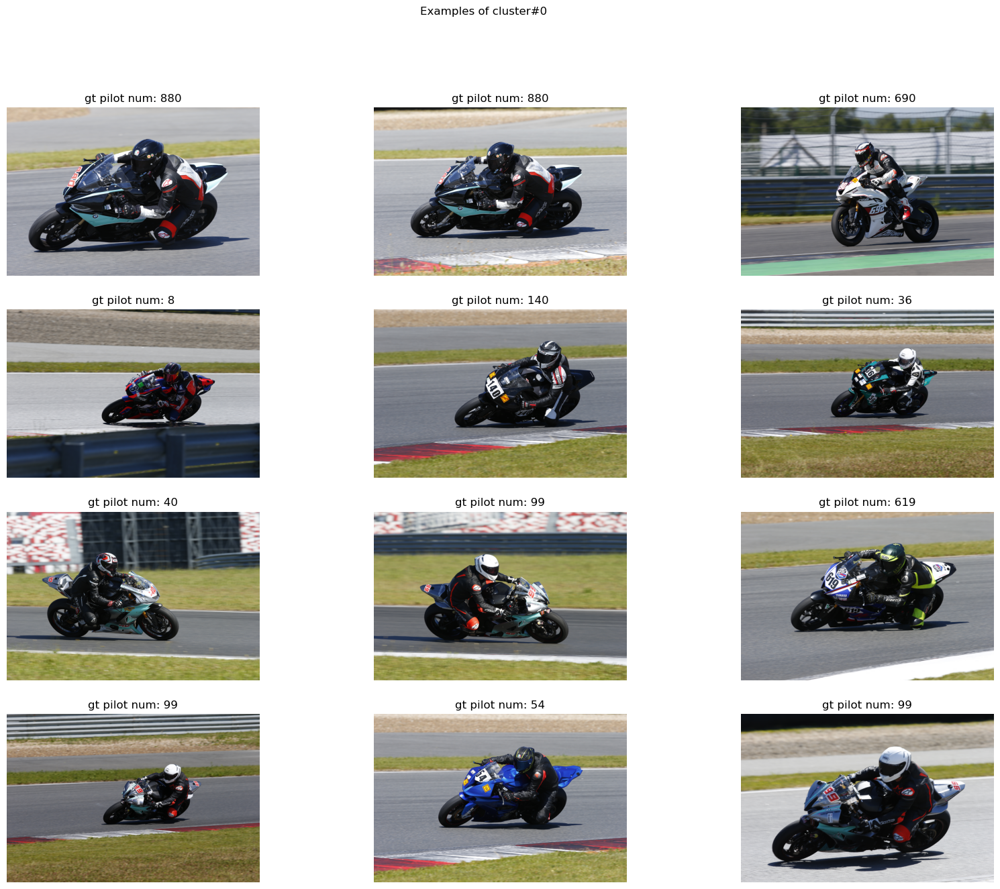

Cluster=1 elems count: 7


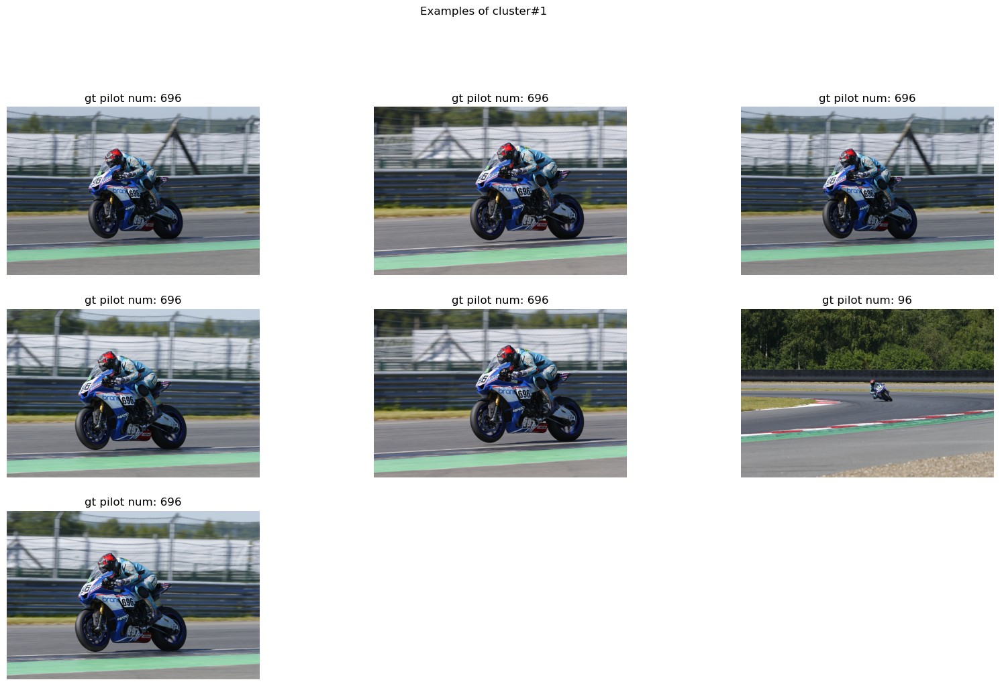

Cluster=2 elems count: 24


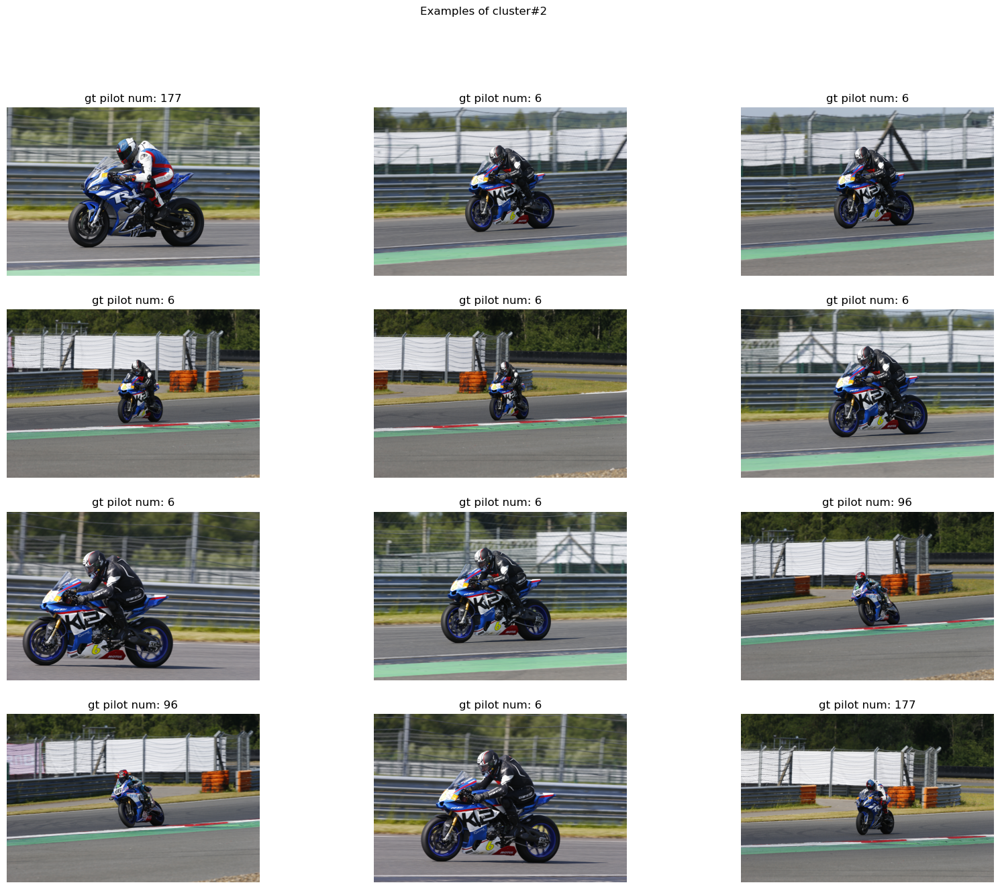

Cluster=3 elems count: 5


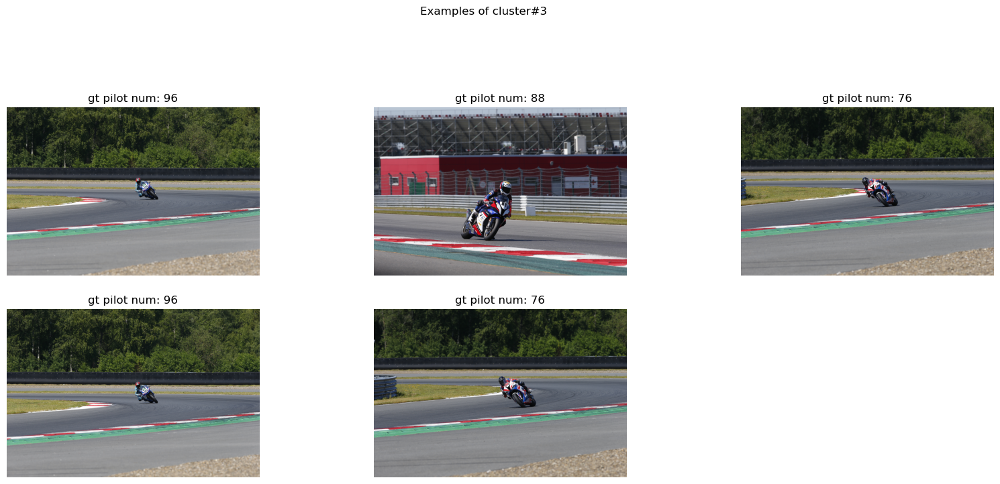

Cluster=4 elems count: 5


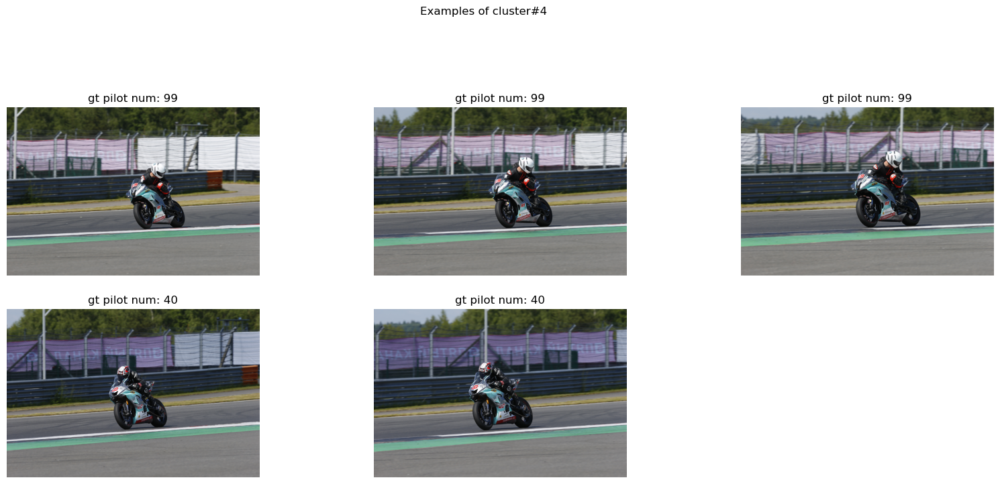

Cluster=5 elems count: 6


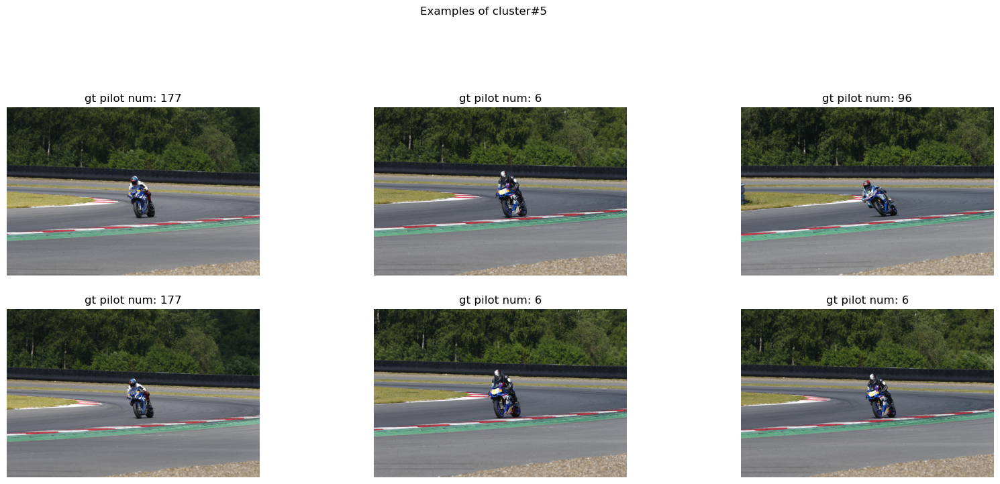

Cluster=6 elems count: 7


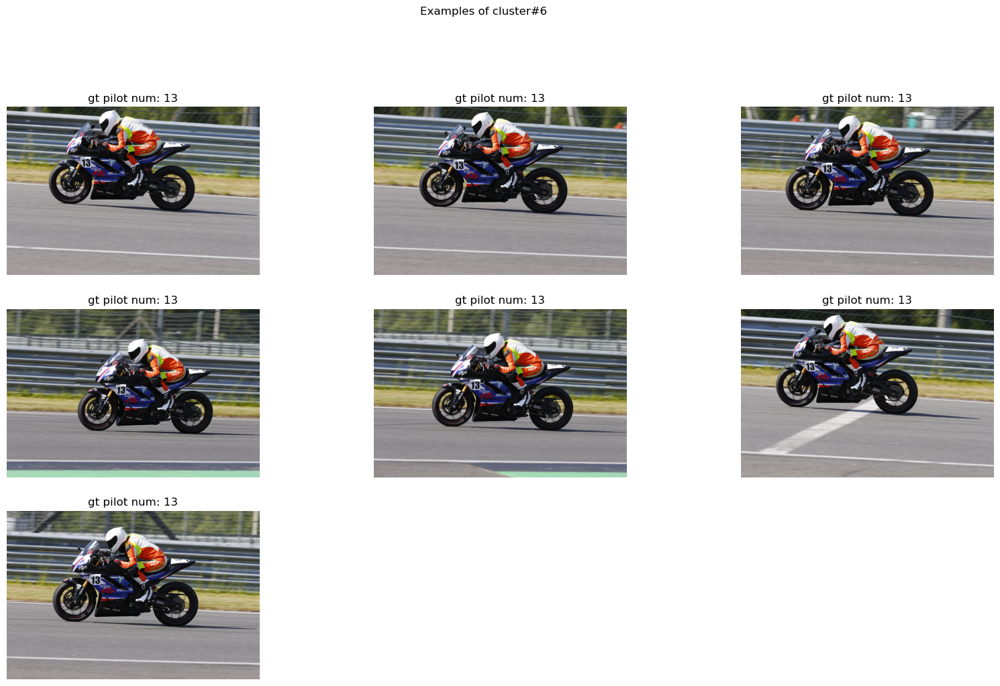

Cluster=7 elems count: 5


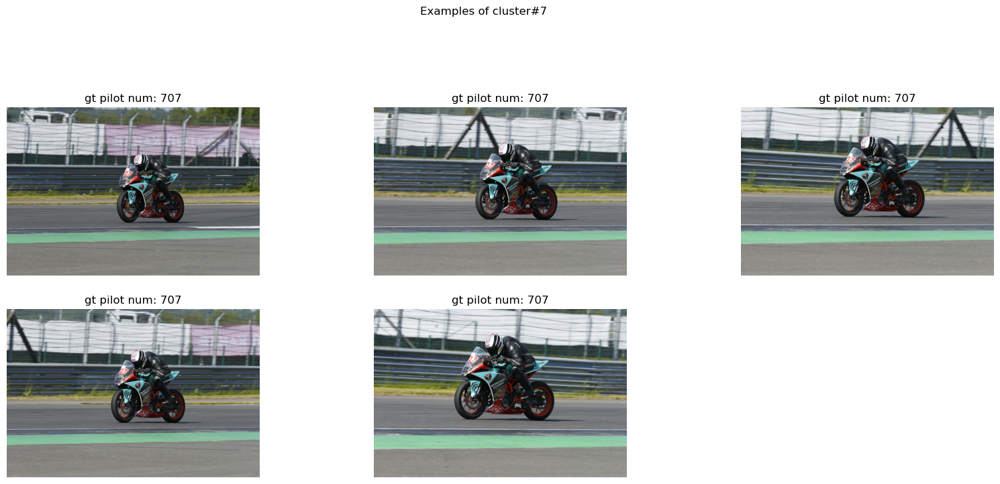

Cluster=8 elems count: 5


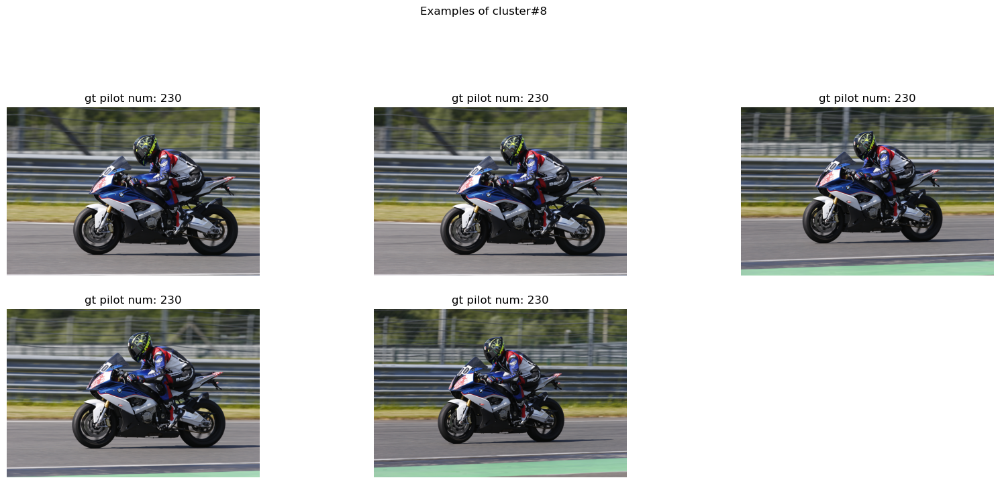

Cluster=9 elems count: 5


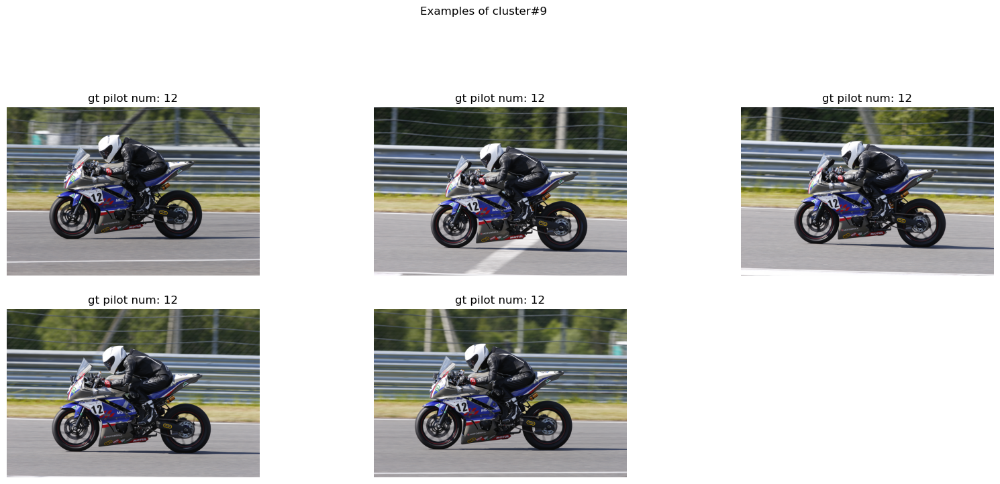

In [37]:
for cluster_id in range(10):
    show_cluster_examples_imgs(cluster_id, dbscan_result, img_paths)

Cluster=10 elems count: 6


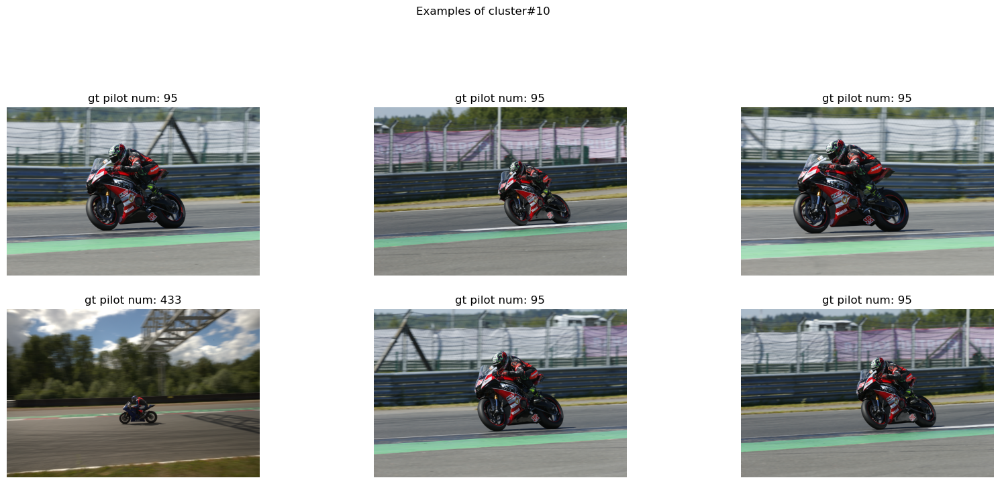

Cluster=11 elems count: 5


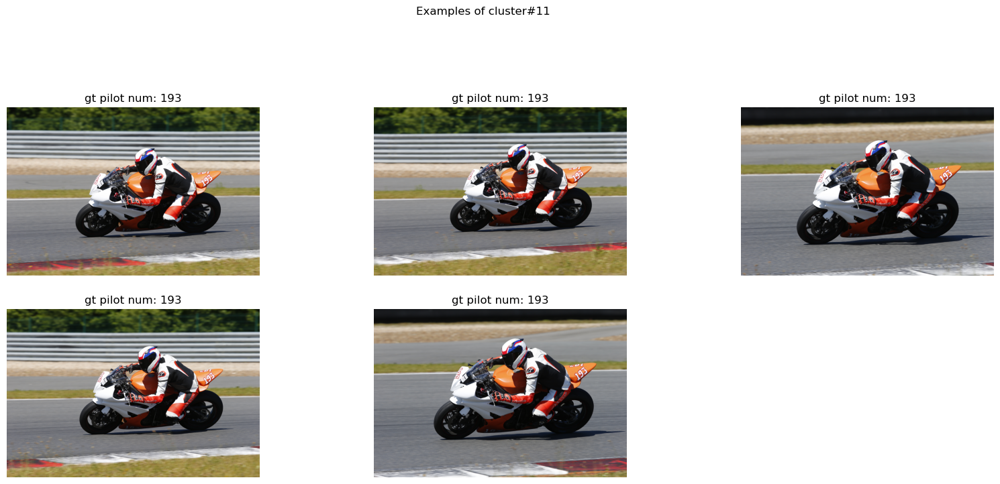

Cluster=12 elems count: 7


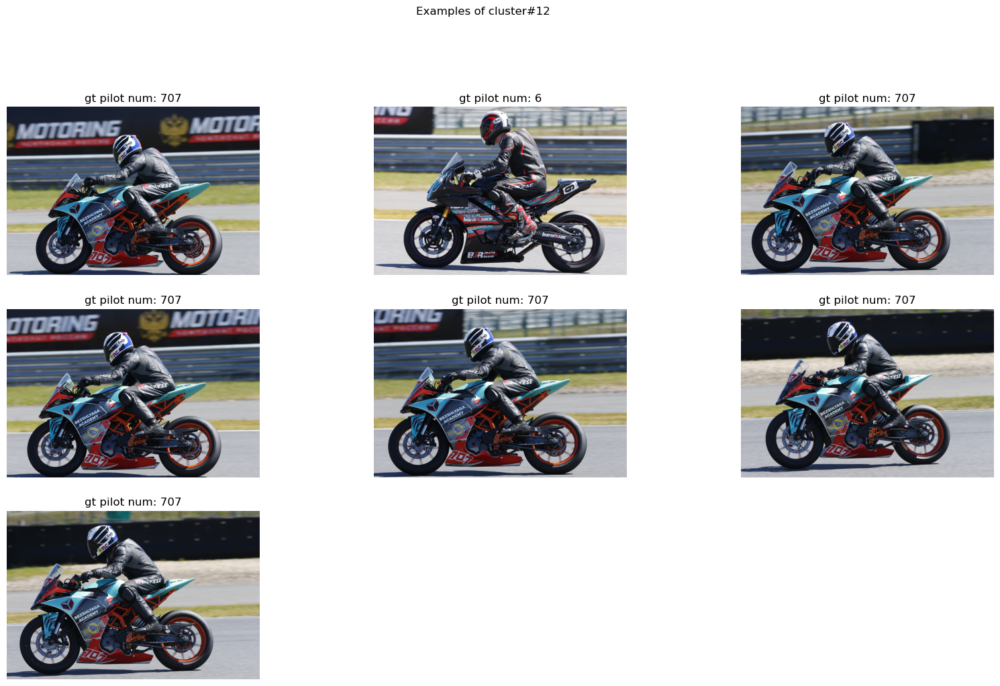

Cluster=13 elems count: 7


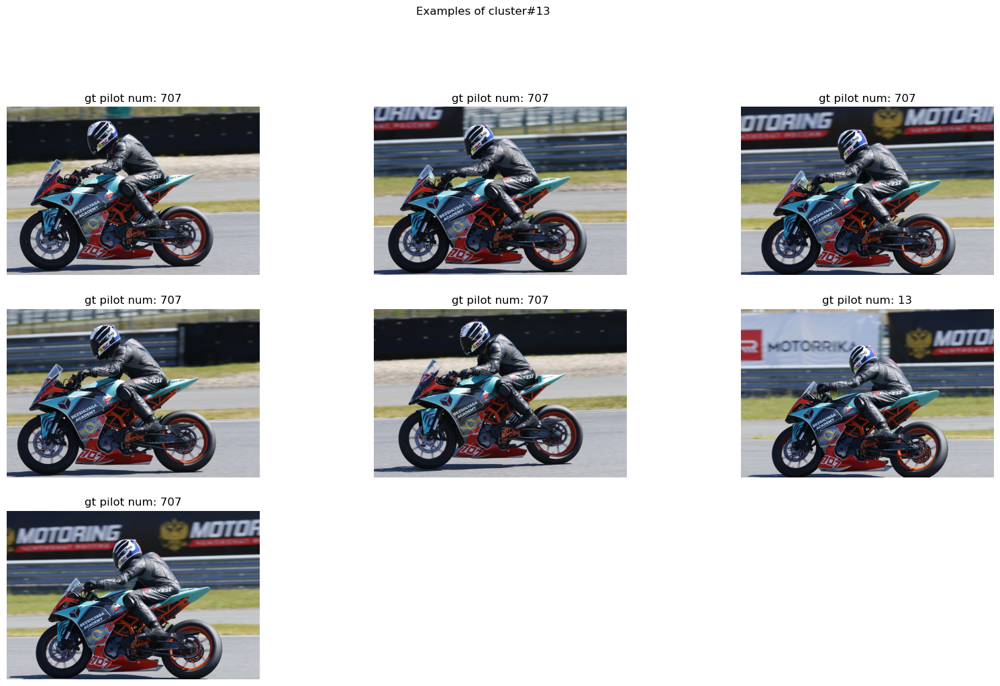

Cluster=14 elems count: 5


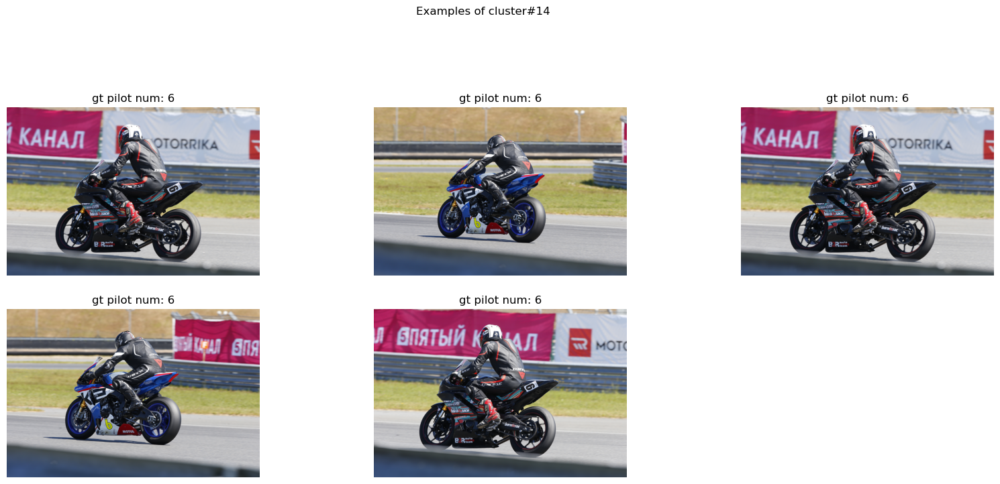

Cluster=15 elems count: 6


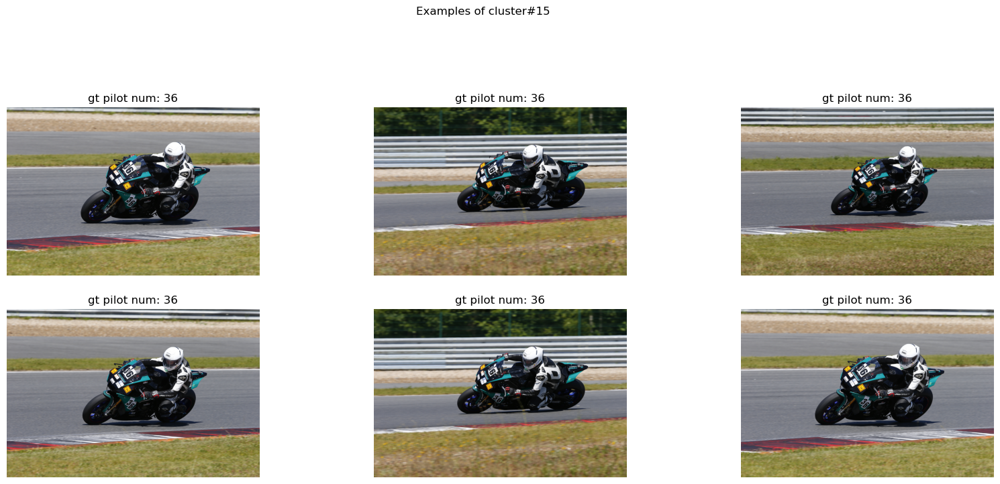

Cluster=16 elems count: 6


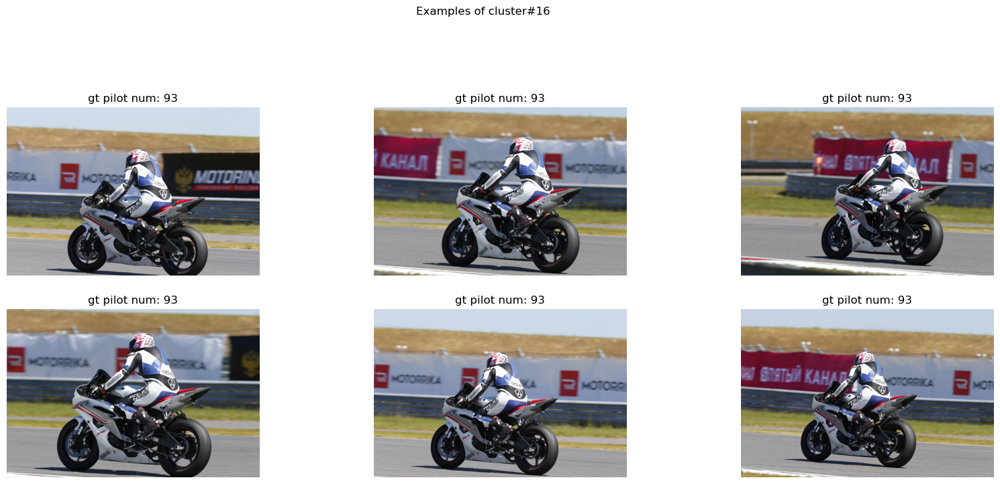

Cluster=17 elems count: 5


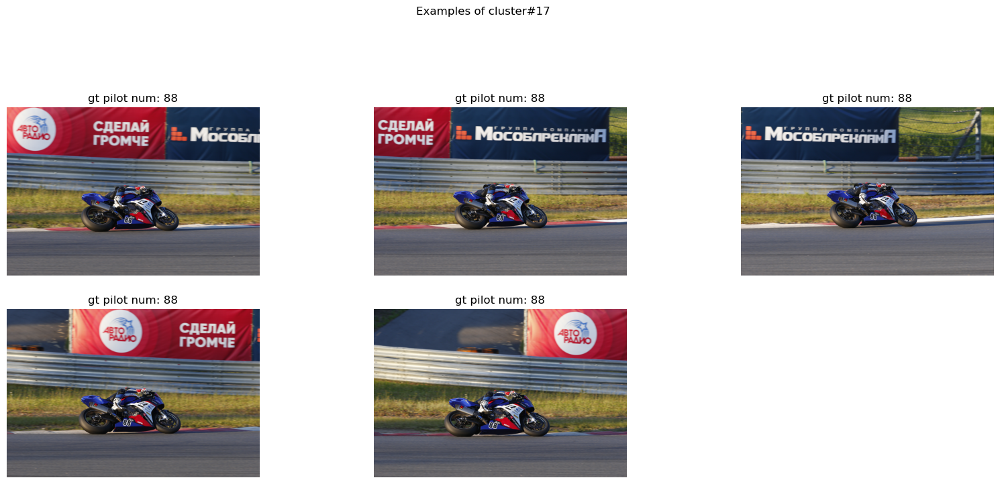

Cluster=18 elems count: 6


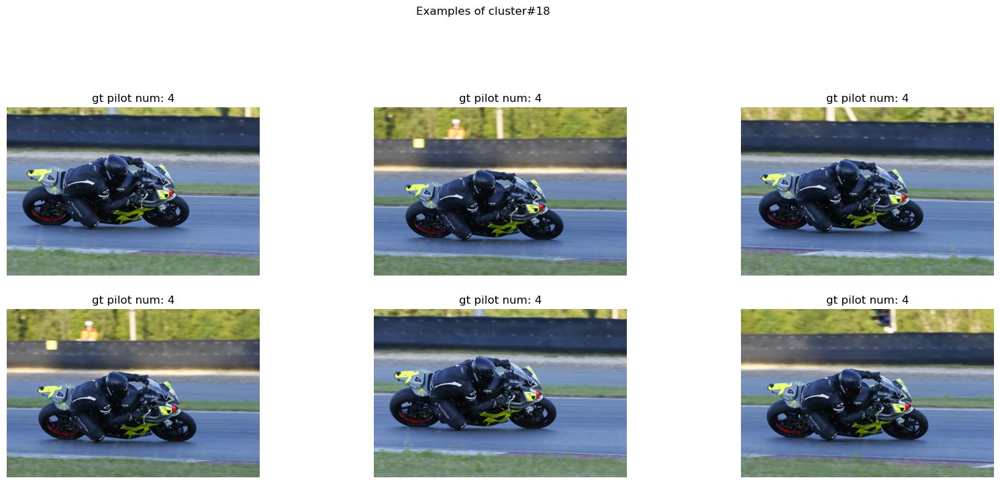

Cluster=19 elems count: 7


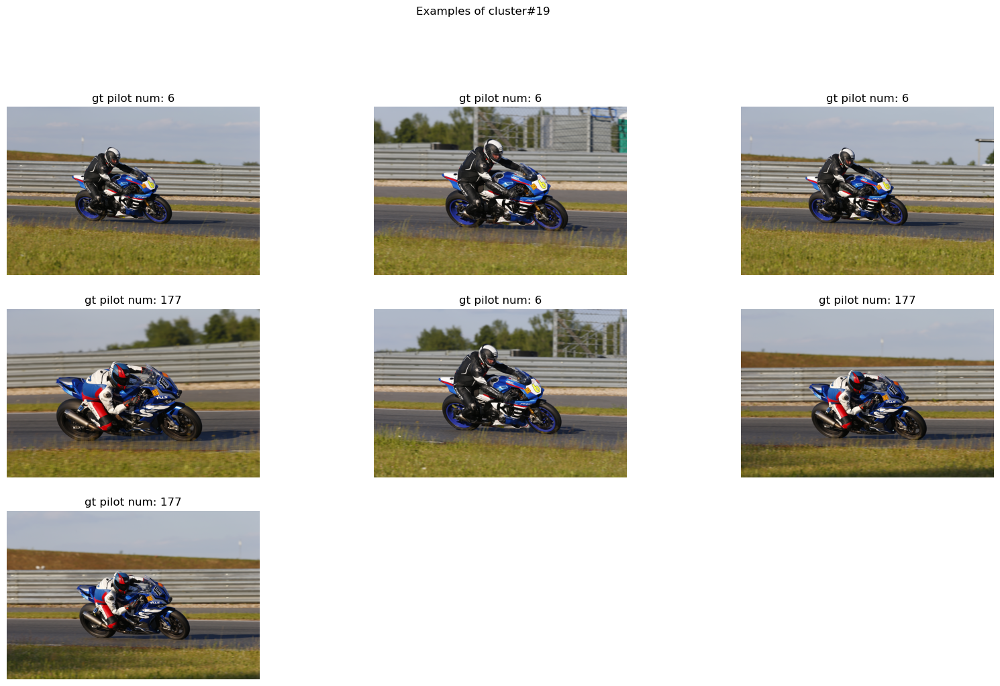

In [38]:
for cluster_id in range(10, 20):
    show_cluster_examples_imgs(cluster_id, dbscan_result, img_paths)

Noisy points:
Cluster=-1 elems count: 1218


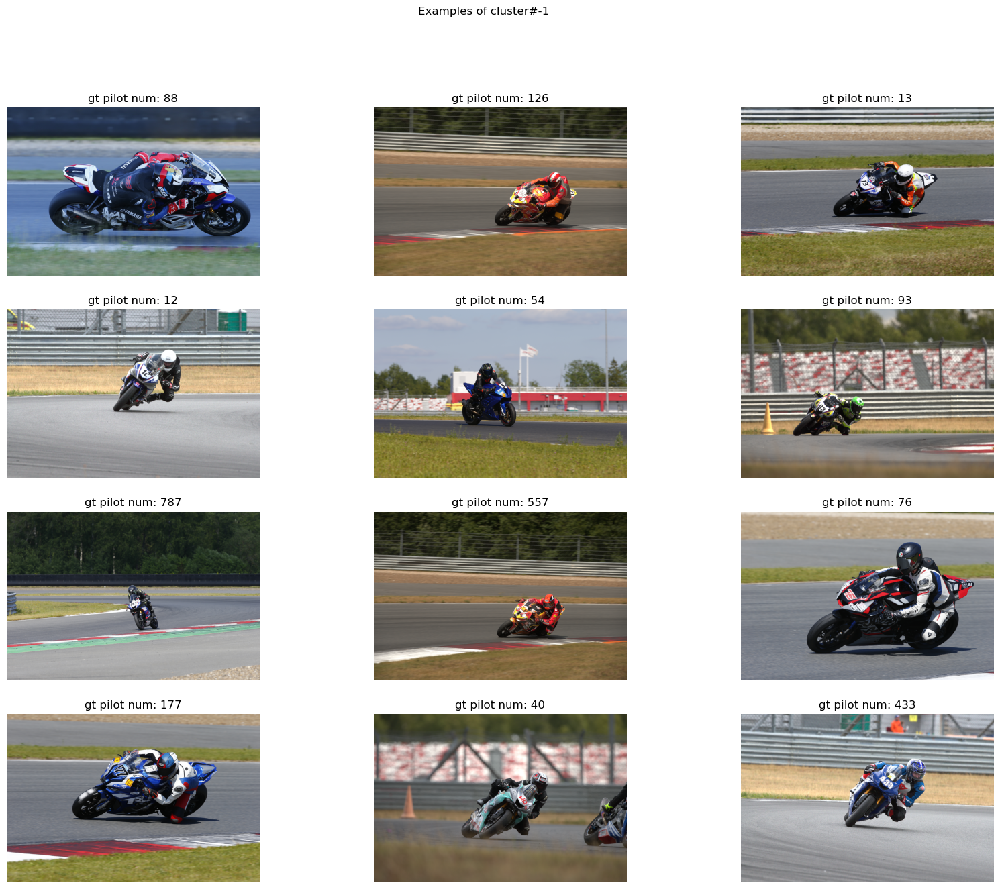

In [39]:
print('Noisy points:')
show_cluster_examples_imgs(-1, dbscan_result, img_paths)

In [41]:
X.shape[0]

2045

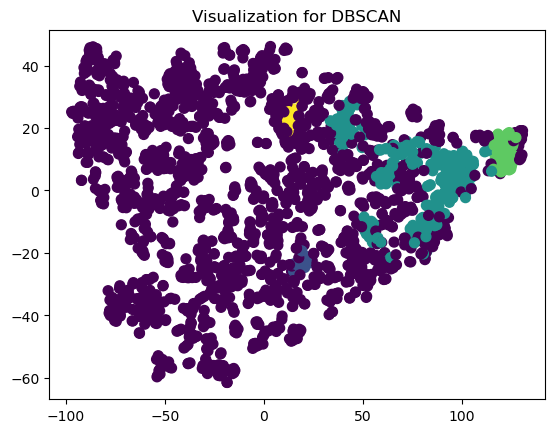

In [42]:
from sklearn.cluster import DBSCAN

# define the model
dbscan_model = DBSCAN(eps=0.05, min_samples=15)

# assign each data point to a cluster
dbscan_result = dbscan_model.fit_predict(X)

# get all of the unique clusters
dbscan_clusters = np.unique(dbscan_result)

plt.title(f'Visualization for DBSCAN')
plt.scatter(x, y, c=dbscan_result, s=50, cmap='viridis')
plt.show()

Cluster=0 elems count: 18


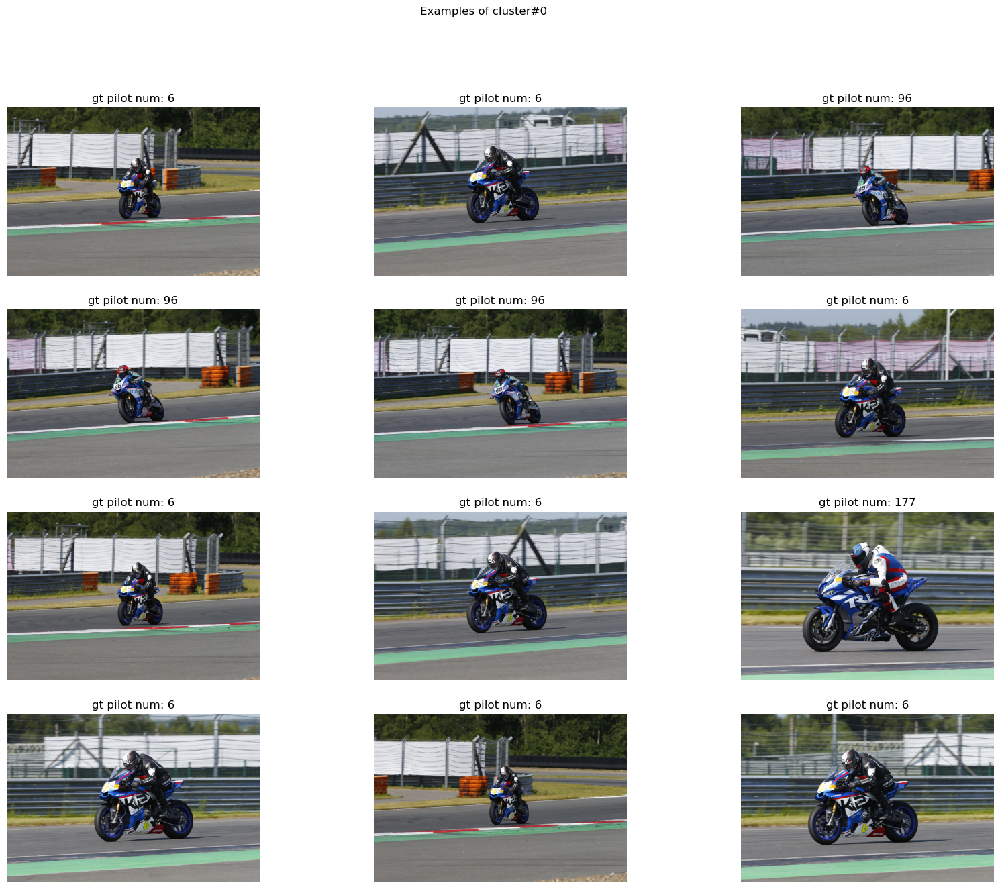

Cluster=1 elems count: 244


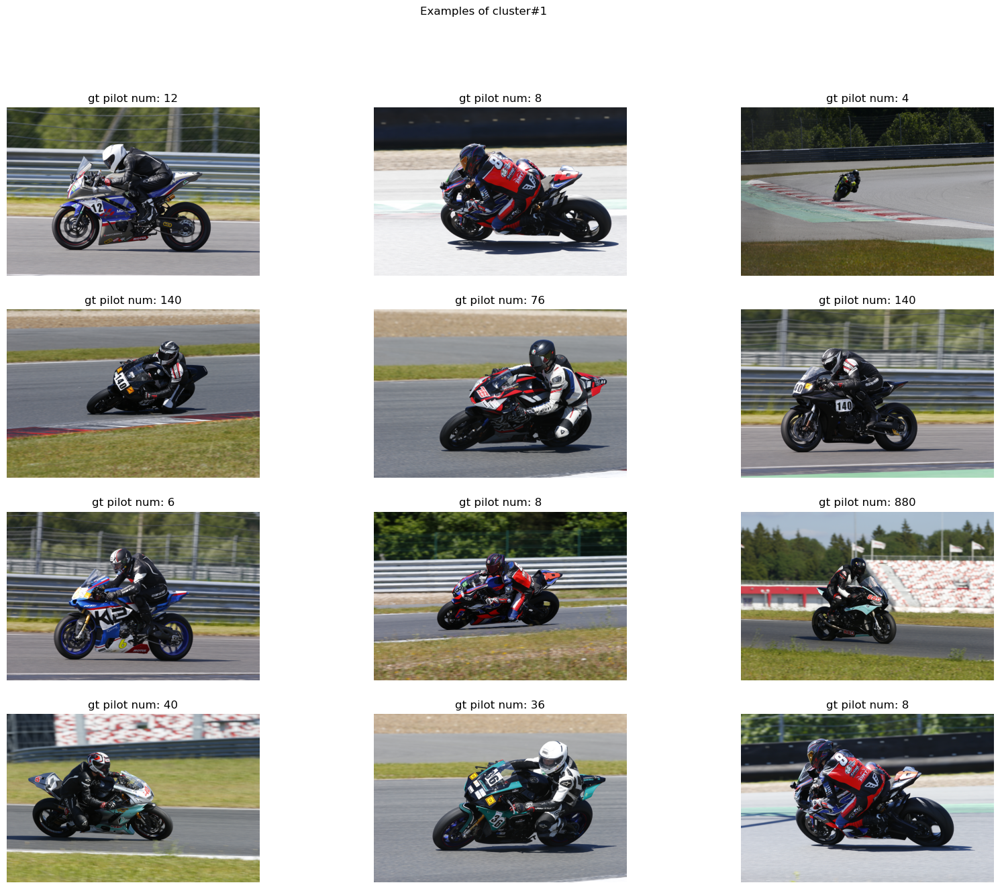

Cluster=2 elems count: 54


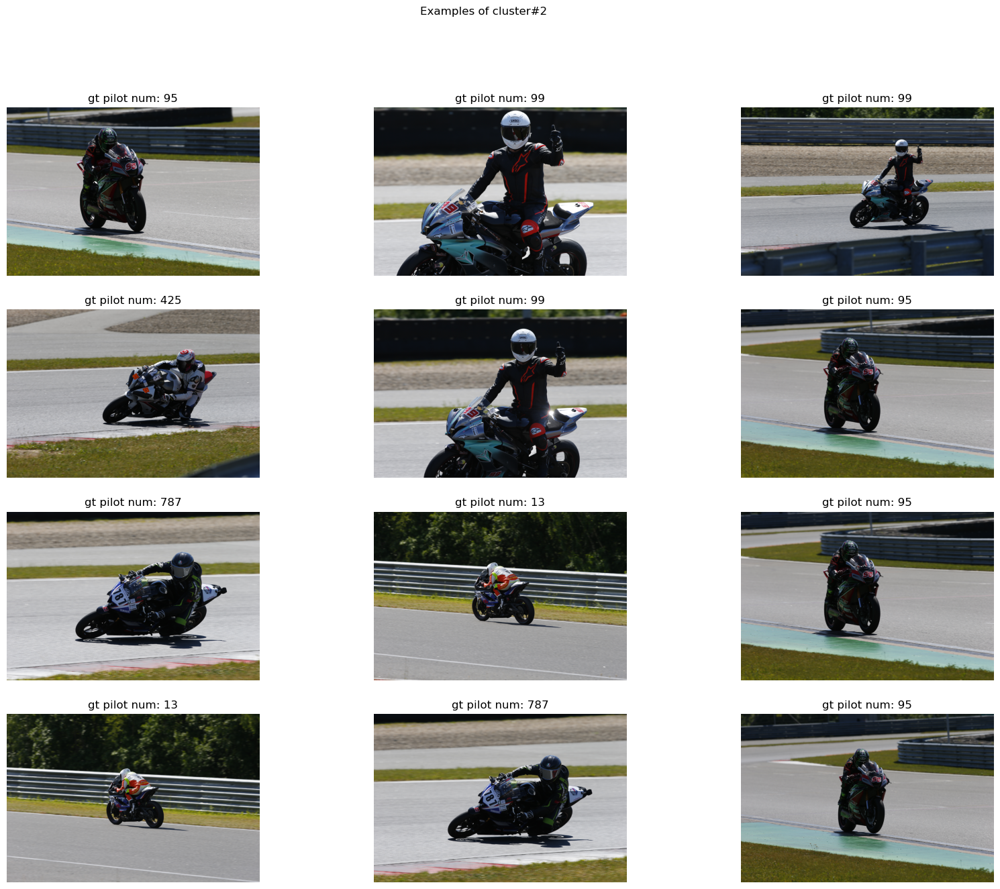

Cluster=3 elems count: 14


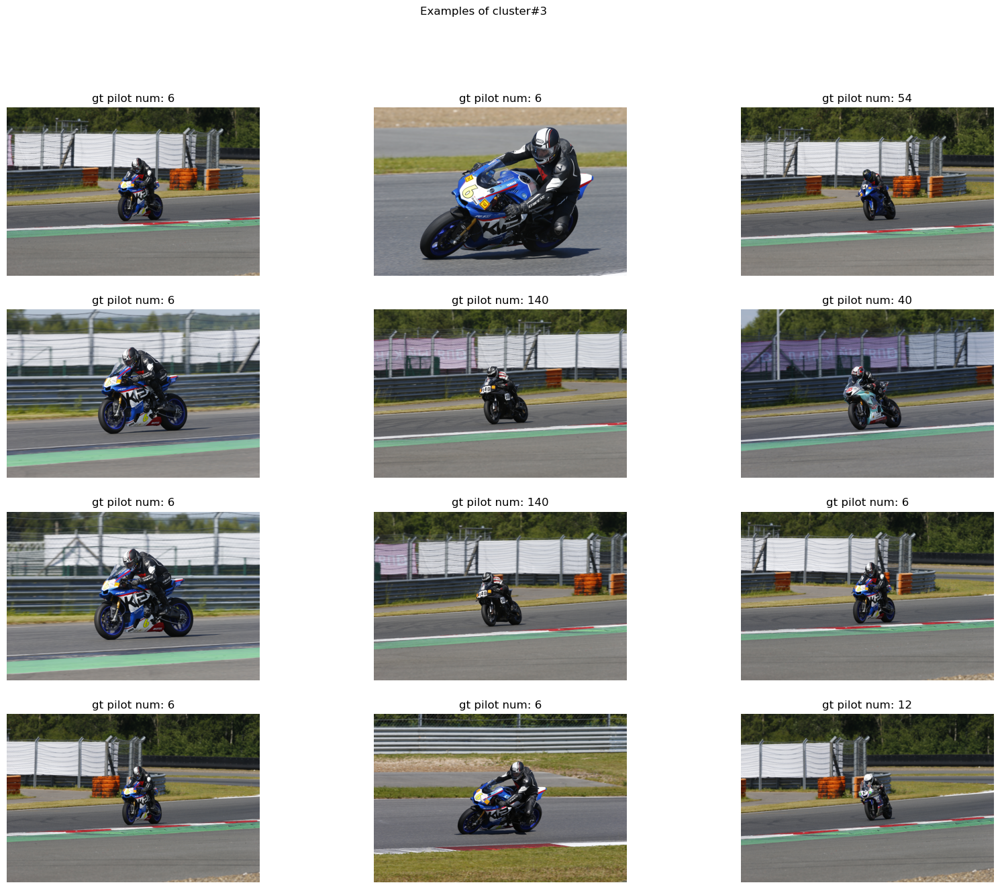

Cluster=4 elems count: 0
Cluster=5 elems count: 0
Cluster=6 elems count: 0
Cluster=7 elems count: 0
Cluster=8 elems count: 0
Cluster=9 elems count: 0


<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

In [43]:
for cluster_id in range(10):
    show_cluster_examples_imgs(cluster_id, dbscan_result, img_paths)